In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'
%reload_ext lab_black

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import seaborn as sns
import logging

FORMAT = "%(asctime)s %(message)s"

logging.basicConfig(level="INFO", format=FORMAT, datefmt="%d-%b-%y %H:%M:%S")
sns.set_context("talk")

In [3]:
epoch_key = ("peanut", 14, 4)  # animal, day, epoch

In [4]:
from dask.distributed import Client

# for typhoon
client = Client(n_workers=48, threads_per_worker=2, processes=True)

client

/home/jguidera/anaconda3/envs/jg_clusterless_decoding/lib/python3.8/site-packages/distributed/node.py:151: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 38683 instead
  warnings.warn(


Client Scheduler: tcp://127.0.0.1:37676 Dashboard: http://127.0.0.1:38683/status,Cluster Workers: 48 Cores: 96 Memory: 2.16 TB


In [5]:
from src.load_data import load_data

data = load_data(epoch_key)

01-Feb-21 10:18:38 Loading position information and linearizing...
01-Feb-21 10:18:43 Loading multiunits...
01-Feb-21 10:19:05 Loading sorted spikes...


In [6]:
logging.info("Done...")

01-Feb-21 10:41:16 Done...


In [7]:
data["neuron_info"].area.value_counts()

OFC     222
mPFC    133
CA1      51
Name: area, dtype: int64

In [8]:
continuous_transition_types = [["random_walk", "uniform"], ["uniform", "uniform"]]


classifier_parameters = {
    "movement_var": 6.0,
    "replay_speed": 1,
    "place_bin_size": 2.5,
    "continuous_transition_types": continuous_transition_types,
    "discrete_transition_diag": 0.968,
    "knot_spacing": 8,
    "spike_model_penalty": 0.5,
}

In [9]:
from replay_trajectory_classification import SortedSpikesClassifier
from sklearn.model_selection import KFold
from src.parameters import EDGE_ORDER, EDGE_SPACING


areas = data["neuron_info"].area.unique()
state_names = ["Continuous", "Fragmented"]

for area in areas:
    logging.info(f"Decoding {area}...")

    cv = KFold()
    results = []

    neuron_id = data["neuron_info"].loc[data["neuron_info"].area == area].neuron_id
    spikes = data["spikes"].loc[:, neuron_id]

    for fold_ind, (train, test) in enumerate(cv.split(data["position_info"].index)):
        logging.info(f"Fitting Fold #{fold_ind + 1}...")
        classifier = SortedSpikesClassifier(**classifier_parameters)
        classifier.fit(
            position=data["position_info"].iloc[train].linear_position,
            spikes=spikes.iloc[train],
            track_graph=data["track_graph"],
            edge_order=EDGE_ORDER,
            edge_spacing=EDGE_SPACING,
        )

        logging.info("Predicting posterior...")
        results.append(
            classifier.predict(
                spikes.iloc[test],
                time=data["position_info"].iloc[test].index / np.timedelta64(1, "s"),
                state_names=state_names,
            )
        )
        classifier.save_model(
            f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_"
            f"sortedspikes_{area}_model_fold{fold_ind}.pkl"
        )

    # concatenate cv classifier results
    results = xr.concat(results, dim="time")

    results.to_netcdf(
        f"{epoch_key[0]}_{epoch_key[1]:02d}_{epoch_key[2]:02d}_"
        f"sortedspikes_{area}_results.nc"
    )

logging.info("Done...\n\n")

01-Feb-21 10:41:18 Decoding CA1...
01-Feb-21 10:41:18 Fitting Fold #1...
01-Feb-21 10:41:18 Fitting initial conditions...
01-Feb-21 10:41:20 Fitting state transition...
01-Feb-21 10:41:20 Fitting place fields...
01-Feb-21 10:46:35 Predicting posterior...
01-Feb-21 10:53:12 Fitting Fold #2...
01-Feb-21 10:53:13 Fitting initial conditions...
01-Feb-21 10:53:13 Fitting state transition...
01-Feb-21 10:53:14 Fitting place fields...
01-Feb-21 10:57:58 Predicting posterior...
01-Feb-21 11:05:37 Fitting Fold #3...
01-Feb-21 11:05:37 Fitting initial conditions...
01-Feb-21 11:05:37 Fitting state transition...
01-Feb-21 11:05:38 Fitting place fields...
01-Feb-21 11:09:39 Predicting posterior...
01-Feb-21 11:18:07 Fitting Fold #4...
01-Feb-21 11:18:07 Fitting initial conditions...
01-Feb-21 11:18:07 Fitting state transition...
01-Feb-21 11:18:08 Fitting place fields...
01-Feb-21 11:22:01 Predicting posterior...
01-Feb-21 11:29:09 Fitting Fold #5...
01-Feb-21 11:29:10 Fitting initial conditions..

In [10]:
client.close()

KeyboardInterrupt: 

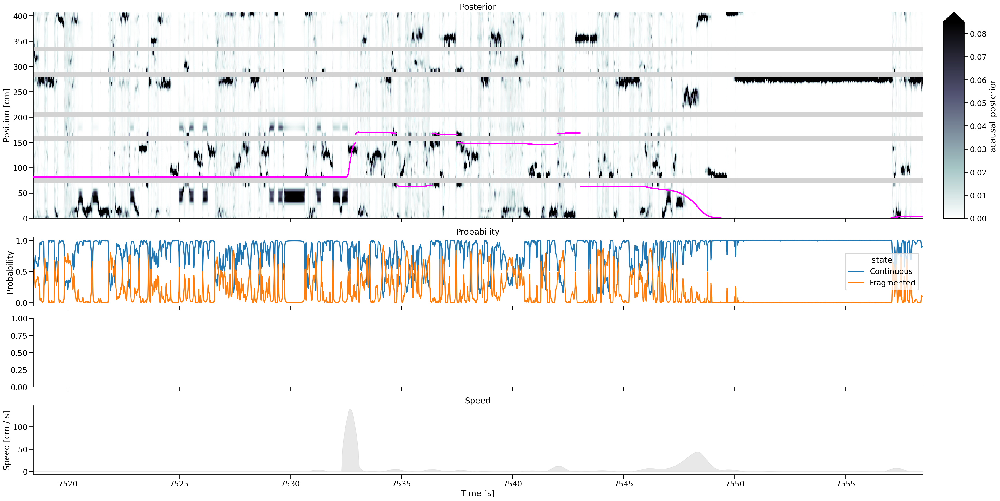

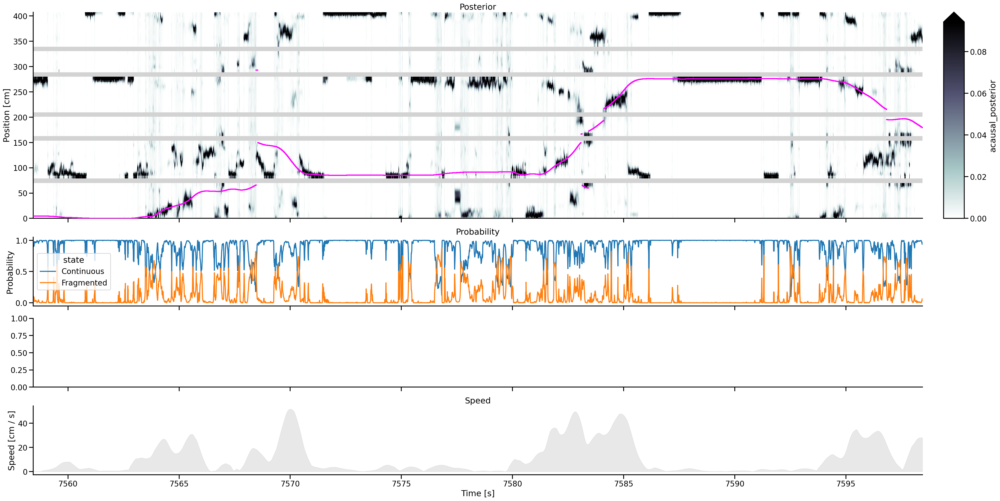

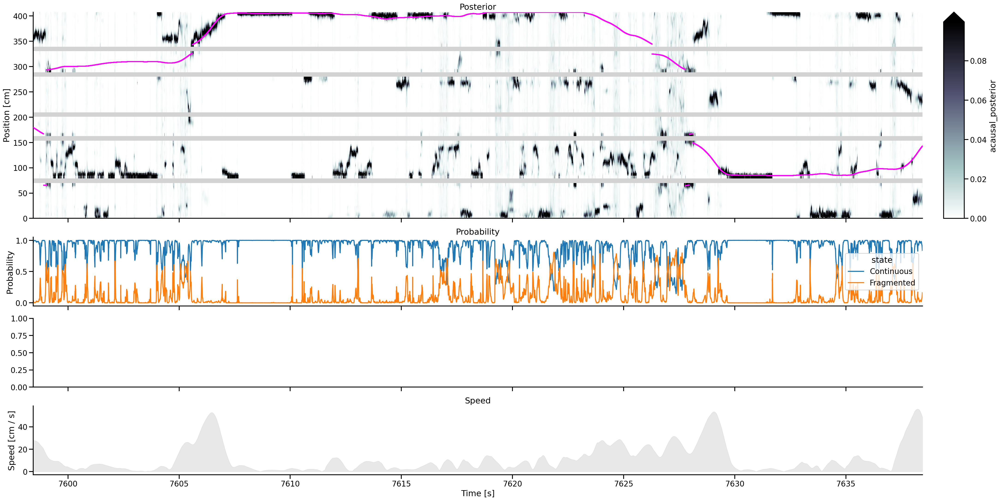

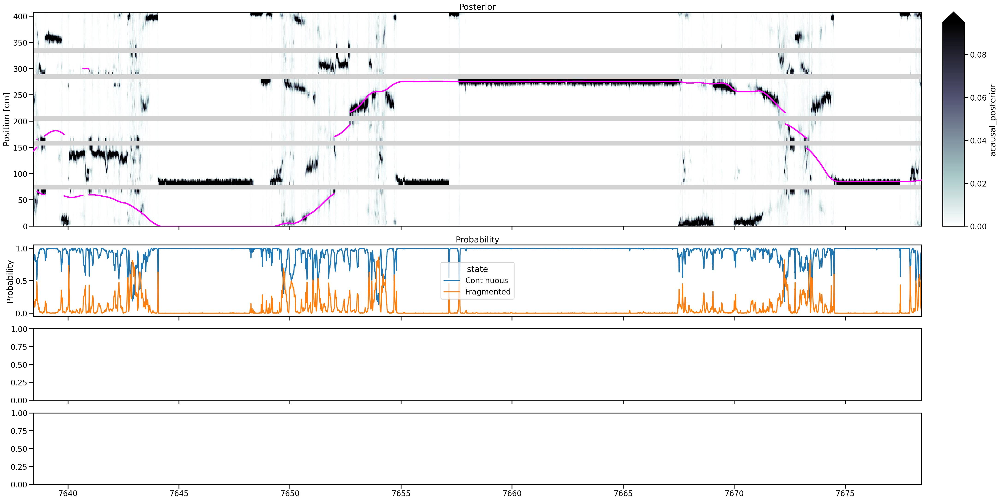

In [11]:
from src.visualization import plot_classifier_time_slice_sorted_spikes
import xarray as xr

results = xr.open_dataset("peanut_14_04_sortedspikes_mPFC_results.nc")
classifier = SortedSpikesClassifier.load_model(
    "peanut_14_04_sortedspikes_mPFC_model_fold0.pkl"
)

time = results.time.values

time_ind = np.arange(0, len(time), 20_000)
time_ind = np.append(time_ind, len(time) - 1)

for start_ind, end_ind in zip(time_ind[:-1], time_ind[1:]):
    time_slice = slice(time[start_ind], time[end_ind])

    plot_classifier_time_slice_sorted_spikes(
        time_slice,
        classifier,
        results,
        data,
        posterior_type="acausal_posterior",
        figsize=(30, 15),
    )

In [ ]:
from src.visualization import plot_classifier_time_slice_sorted_spikes
import xarray as xr

results = xr.open_dataset("peanut_14_04_sortedspikes_CA1_results.nc")
classifier = SortedSpikesClassifier.load_model(
    "peanut_14_04_sortedspikes_CA1_model_fold0.pkl"
)

time = results.time.values

time_ind = np.arange(0, len(time), 20_000)
time_ind = np.append(time_ind, len(time) - 1)

for start_ind, end_ind in zip(time_ind[:-1], time_ind[1:]):
    time_slice = slice(time[start_ind], time[end_ind])

    plot_classifier_time_slice_sorted_spikes(
        time_slice,
        classifier,
        results,
        data,
        posterior_type="acausal_posterior",
        figsize=(30, 15),
    )

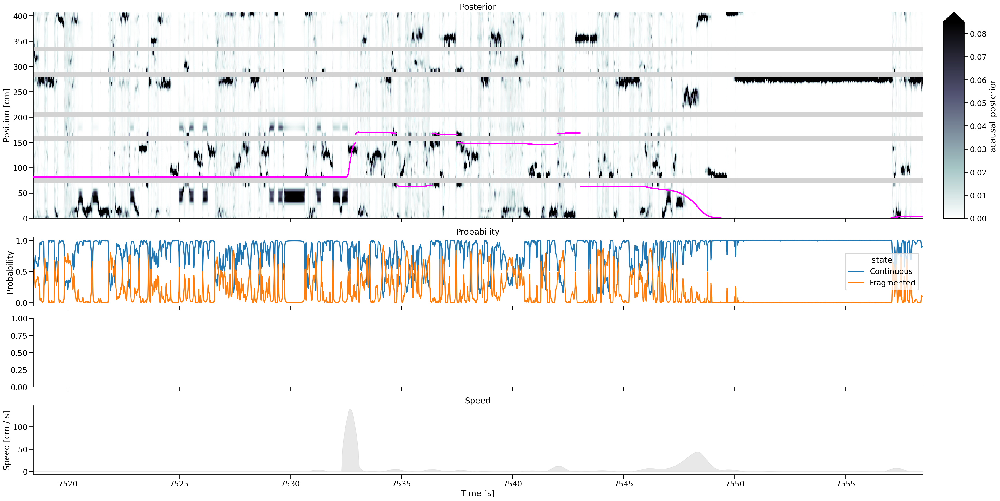

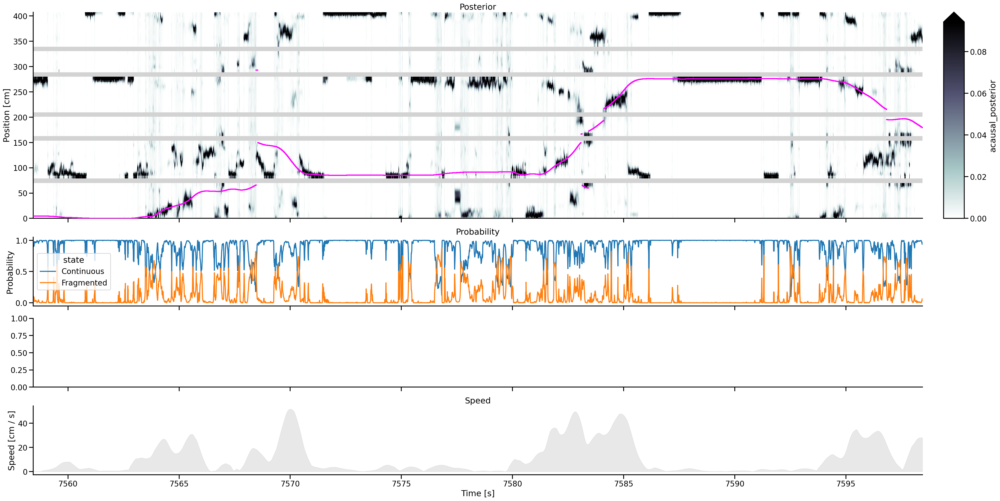

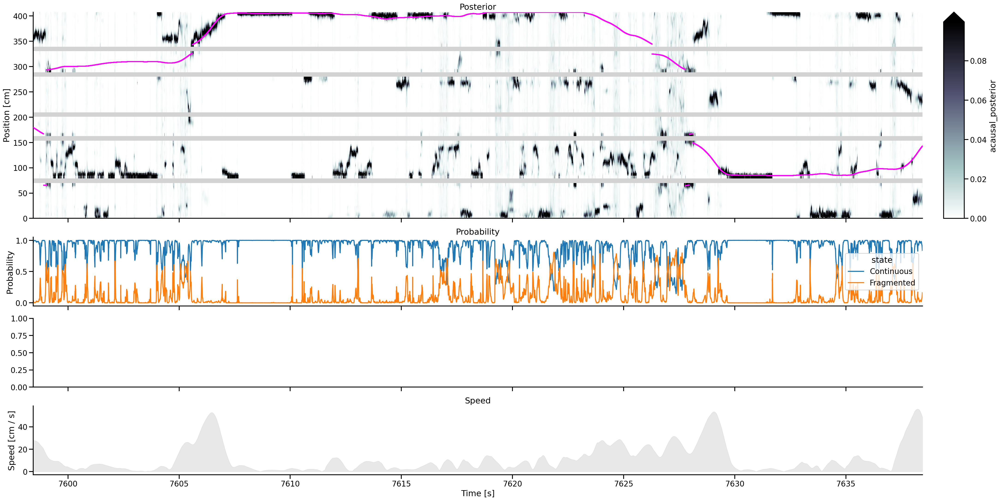

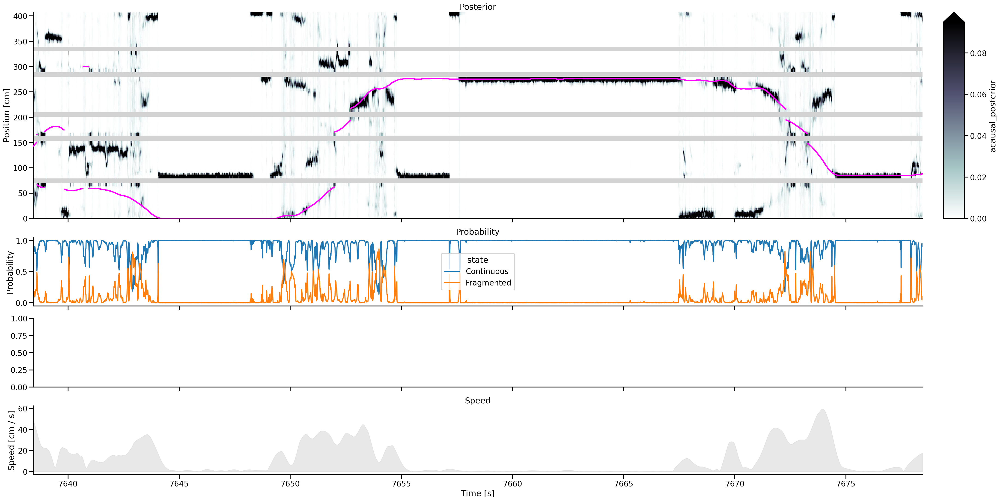

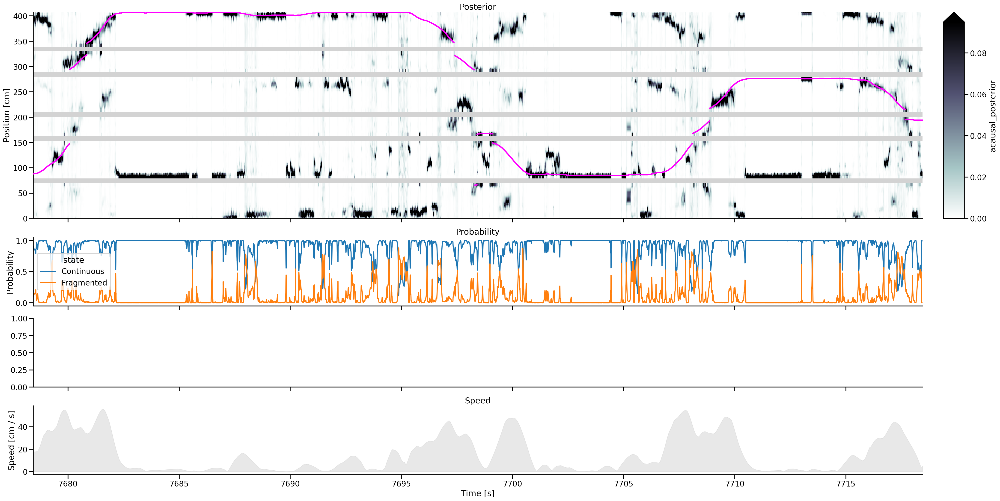

...

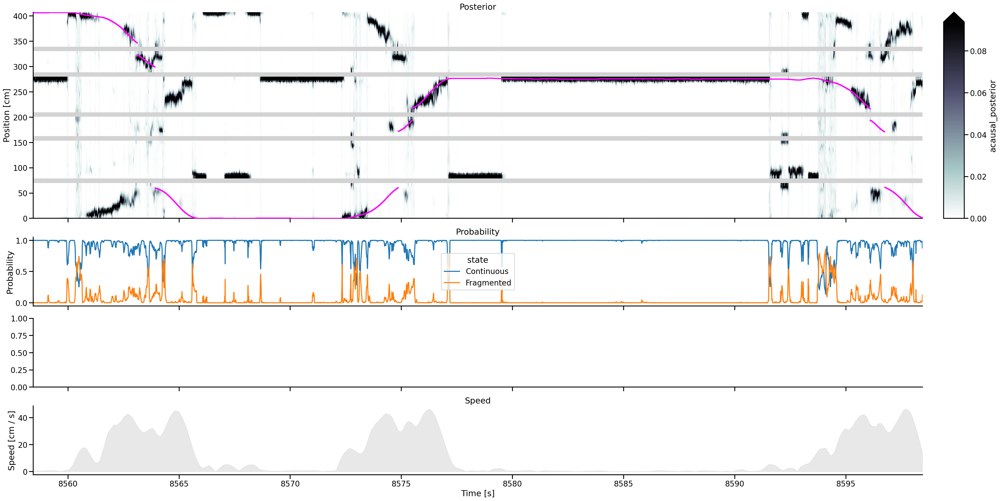

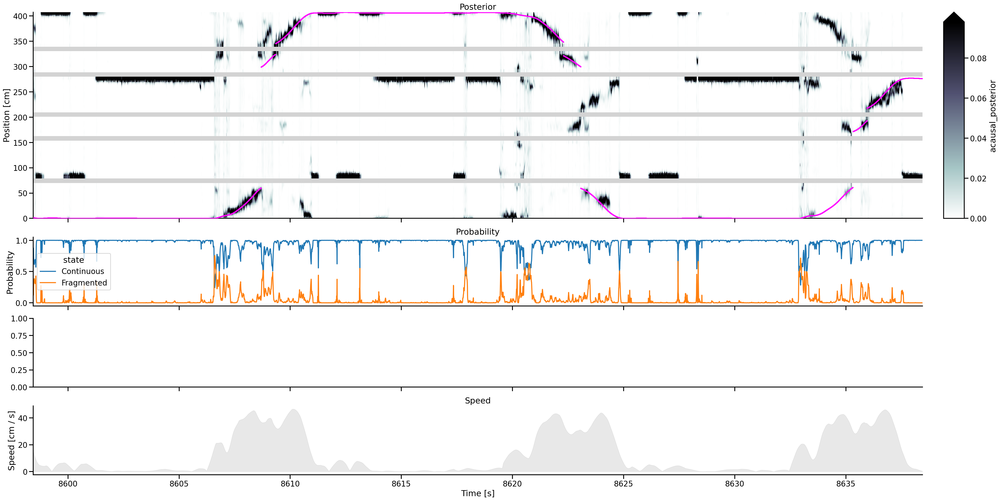

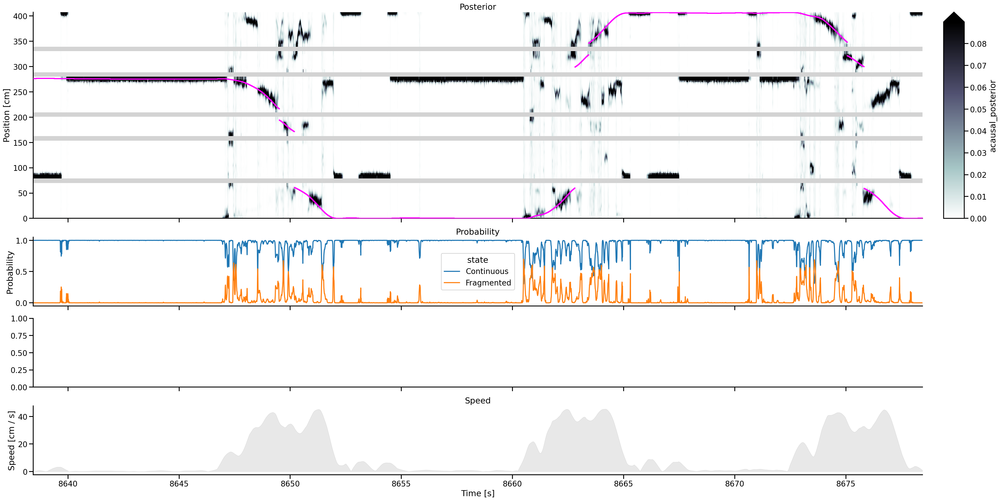

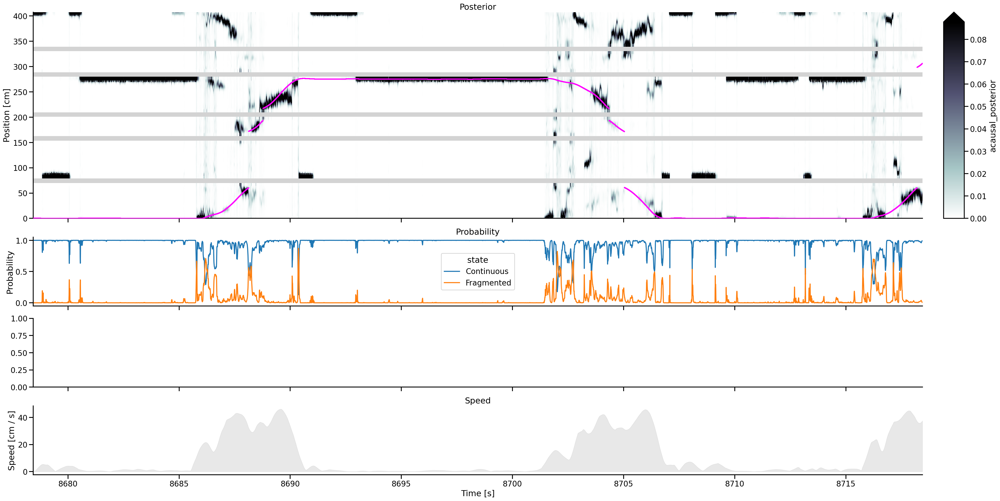

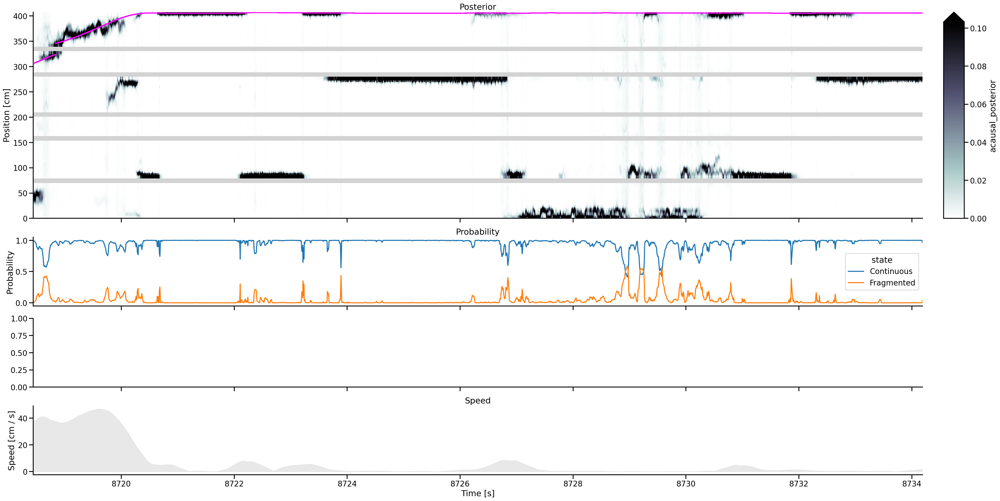

In [12]:
from src.visualization import plot_classifier_time_slice_sorted_spikes
import xarray as xr

results = xr.open_dataset("peanut_14_04_sortedspikes_OFC_results.nc")
classifier = SortedSpikesClassifier.load_model(
    "peanut_14_04_sortedspikes_OFC_model_fold0.pkl"
)

time = results.time.values

time_ind = np.arange(0, len(time), 20_000)
time_ind = np.append(time_ind, len(time) - 1)

for start_ind, end_ind in zip(time_ind[:-1], time_ind[1:]):
    time_slice = slice(time[start_ind], time[end_ind])

    plot_classifier_time_slice_sorted_spikes(
        time_slice,
        classifier,
        results,
        data,
        posterior_type="acausal_posterior",
        figsize=(30, 15),
    )